# Creating Keyword Spotting Model For Voice Assistant "Numa"

(1) Importing Necessary Libraries

In [1]:
# Important Library
import os
import json
from pprint import pprint
import random

# Audio Data Analysis Library
import librosa
import numpy as np
import pandas as pd

# Data Visualization Library
import librosa.display
import IPython.display as ipd
import matplotlib.pyplot as plt
import seaborn as sns

(2) Reading and Exploring Data 

In [2]:
"""
Creating dataframe of json file.

:param orginal_df (DataFrame) : Dataframe of json data. 
:param df : Copy file of orginal_df.
"""

json_Path_English = "/home/atomyongya/Documents/Herald/Final Year Project/VoiceAssistant(Numa)/VoiceAssistant/1 System Model/2_English_KM/2_English_Json_Output_File/English_Data_JSON.json"

orginal_df = pd.read_json(json_Path_English, orient='index')
df = orginal_df

"""
Applying transpose() function which changes the row elements into column 
elements and the column elements into row elements.
"""

df = df.transpose()
df.head(20)

,mappings,labels,MFCCs,files
0,file,0,"[[-757.322509765625, -2.326998710632324, -0.86...",/home/atomyongya/Documents/Herald/Final Year P...
1,open,0,"[[-820.5107421875, 19.644493103027344, 4.52003...",/home/atomyongya/Documents/Herald/Final Year P...
2,chrome,0,"[[-768.443603515625, 0.0, 0.0, 0.0, 0.0, 0.0, ...",/home/atomyongya/Documents/Herald/Final Year P...
3,close,0,"[[-855.1250610351562, 0.0, 0.0, 0.0, 0.0, 0.0,...",/home/atomyongya/Documents/Herald/Final Year P...
4,folder,0,"[[-978.7564697265625, -9.972305297851562, 8.94...",/home/atomyongya/Documents/Herald/Final Year P...
5,google,0,"[[-829.8956298828125, 66.89012145996094, 66.90...",/home/atomyongya/Documents/Herald/Final Year P...
6,numa,0,"[[-840.1062622070312, 6.9649152755737305, -38....",/home/atomyongya/Documents/Herald/Final Year P...
7,shutdown,0,"[[-832.75146484375, 44.155982971191406, -14.18...",/home/atomyongya/Documents/Herald/Final Year P...
8,play,0,"[[-871.768310546875, 0.0, 0.0, 0.0, 0.0, 0.0, ...",/home/atomyongya/Documents/Herald/Final Year P...
9,youtube,0,"[[-773.2343139648438, 95.66471862792969, 11.54...",/home/atomyongya/Documents/Herald/Final Year P...


In [3]:
# Finding null value
df.isna().sum()

mappings    917
labels        0
MFCCs         0
files         0
dtype: int64

In [4]:
# Shape of dataframe
df.shape

(927, 4)

In [5]:
# Unique class of "mappings" feature.
mapping_Unique_Class = df["mappings"].unique()
mapping_Unique_Class

array(['file', 'open', 'chrome', 'close', 'folder', 'google', 'numa',
       'shutdown', 'play', 'youtube', None], dtype=object)

In [6]:
# Unique class of "labels" feature
labels_Unique_Class = df["labels"].unique()
labels_Unique_Class

array([0, 1, 2, 3, 4, 5, 6, 7, 8, 9], dtype=object)

In [7]:
# Unique class of "files" feature
files_Unique_Class = df["files"].unique()
len(files_Unique_Class)

927

In [8]:
df.describe()

,mappings,labels,MFCCs,files
count,10,927,927,927
unique,10,10,869,927
top,file,2,"[[-666.6397705078125, 73.39788818359375, 11.13...",/home/atomyongya/Documents/Herald/Final Year P...
freq,1,100,2,1


In [9]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 927 entries, 0 to 926
Data columns (total 4 columns):
 #   Column    Non-Null Count  Dtype 
---  ------    --------------  ----- 
 0   mappings  10 non-null     object
 1   labels    927 non-null    object
 2   MFCCs     927 non-null    object
 3   files     927 non-null    object
dtypes: object(4)
memory usage: 29.1+ KB


(3) Data Visualization

In [10]:
"""
Lode json file.

:param data (dict) : Dictonary which store the JSON data. 
"""

with open(json_Path_English) as json_Data:
    data = json.load(json_Data)

pprint(data)

{'MFCCs': [[[-757.322509765625,
             -2.326998710632324,
             -0.8697819709777832,
             3.401592969894409,
             -3.34379243850708,
             0.7456316947937012,
             2.4112253189086914,
             -3.7259488105773926,
             2.2066822052001953,
             0.9801691770553589,
             -3.40639591217041,
             3.2343268394470215,
             -0.6105407476425171],
            [-758.0060424804688,
             -1.7333192825317383,
             -0.6324834227561951,
             2.5171022415161133,
             -2.4951515197753906,
             0.5872137546539307,
             1.7587807178497314,
             -2.7676992416381836,
             1.6821222305297852,
             0.6683312058448792,
             -2.5016725063323975,
             2.4362540245056152,
             -0.5333272218704224],
            [-759.1834106445312,
             -0.6925276517868042,
             -0.26935505867004395,
             1.0241135358810425,


             -27.18643569946289,
             -33.26952362060547,
             -4.412989139556885,
             16.84198570251465,
             15.78244686126709,
             8.329574584960938,
             -0.3533210754394531,
             -14.058488845825195,
             -18.167640686035156,
             0.9824942946434021,
             20.887975692749023],
            [-842.1248168945312,
             13.008255004882812,
             -20.62540054321289,
             -32.25865936279297,
             -3.0953824520111084,
             13.336738586425781,
             18.730567932128906,
             5.112763404846191,
             -1.4235074520111084,
             -16.234811782836914,
             -11.374894142150879,
             1.8854187726974487,
             19.860702514648438],
            [-841.5145263671875,
             4.658336639404297,
             -11.383726119995117,
             -33.55965042114258,
             1.7668745517730713,
             7.971056938171387,
      

             -5.143951416015625,
             19.873119354248047,
             15.360410690307617,
             -10.700956344604492,
             -25.27791976928711,
             -6.370800495147705,
             10.795614242553711,
             -32.76636505126953],
            [-367.5026550292969,
             179.10336303710938,
             13.49790096282959,
             -10.691057205200195,
             -23.66598892211914,
             -12.391324996948242,
             27.35602378845215,
             1.3380746841430664,
             -16.046113967895508,
             -18.870220184326172,
             -9.108409881591797,
             9.620038032531738,
             -32.54425048828125],
            [-293.2056579589844,
             166.7178192138672,
             -40.025753021240234,
             6.773251056671143,
             -33.201133728027344,
             -19.139217376708984,
             44.23662567138672,
             -14.890010833740234,
             -11.00285530090332,
     

             4.4333906173706055,
             6.55580997467041,
             9.23061752319336,
             11.015552520751953,
             10.926109313964844,
             8.94632339477539,
             6.034748077392578,
             3.623814582824707],
            [-739.406494140625,
             10.330351829528809,
             8.596145629882812,
             6.7126922607421875,
             5.636625289916992,
             5.897268772125244,
             7.3225579261779785,
             9.129358291625977,
             10.330727577209473,
             10.248233795166016,
             8.863147735595703,
             6.824674129486084,
             5.11175537109375],
            [-740.1389770507812,
             8.474159240722656,
             6.511621952056885,
             6.598040580749512,
             6.343767166137695,
             4.089598655700684,
             2.9167280197143555,
             4.472539901733398,
             5.551644325256348,
             4.65887975692749,
 

             -0.18670302629470825,
             -8.834314346313477,
             -15.684937477111816,
             -19.69927215576172,
             -20.386796951293945,
             -17.86741828918457,
             -12.813226699829102,
             -6.28770637512207,
             0.4799683094024658],
            [-809.5606689453125,
             18.794286727905273,
             14.323341369628906,
             7.706242561340332,
             0.03770497441291809,
             -7.4331207275390625,
             -13.520977973937988,
             -17.306623458862305,
             -18.286197662353516,
             -16.441818237304688,
             -12.22318172454834,
             -6.4467854499816895,
             -0.13490065932273865],
            [-812.7476806640625,
             14.718405723571777,
             11.455869674682617,
             6.586356163024902,
             0.8623366951942444,
             -4.843933582305908,
             -9.682836532592773,
             -12.9632949829101

             -23.676591873168945,
             -20.33875274658203],
            [-702.543701171875,
             130.88218688964844,
             35.035152435302734,
             24.447654724121094,
             60.69097900390625,
             54.426063537597656,
             17.21452522277832,
             -11.087953567504883,
             -19.569107055664062,
             -21.466861724853516,
             -28.113758087158203,
             -17.266712188720703,
             -16.407651901245117],
            [-734.1870727539062,
             108.55949401855469,
             38.017242431640625,
             30.769908905029297,
             62.27661895751953,
             57.598716735839844,
             22.673799514770508,
             -2.092097282409668,
             -14.861959457397461,
             -19.493934631347656,
             -25.727745056152344,
             -15.27846622467041,
             -11.813836097717285],
            [-769.03857421875,
             82.74837493896484,
   

             168.904296875,
             69.38937377929688,
             -1.2693111896514893,
             -16.40304183959961,
             -10.654586791992188,
             14.325860977172852,
             24.339832305908203,
             -3.5746235847473145,
             -36.466026306152344,
             -27.377227783203125,
             5.1901326179504395,
             7.695904731750488],
            [-679.2286376953125,
             241.92388916015625,
             64.23580932617188,
             -27.963119506835938,
             -32.51066589355469,
             -16.061321258544922,
             11.147903442382812,
             27.732755661010742,
             -11.850610733032227,
             -57.872154235839844,
             -16.39044952392578,
             21.11113929748535,
             -5.351467132568359],
            [-615.4906005859375,
             262.46502685546875,
             33.967594146728516,
             -33.707275390625,
             -35.14289093017578,
          

             -22.730178833007812,
             5.076939105987549,
             5.159437656402588,
             -2.65855073928833,
             -7.115307807922363],
            [-673.3857421875,
             141.86358642578125,
             41.95219039916992,
             35.99228286743164,
             15.260108947753906,
             8.65235710144043,
             24.683727264404297,
             -6.811832427978516,
             -21.700801849365234,
             4.740036964416504,
             2.148712396621704,
             -12.928228378295898,
             -10.052478790283203],
            [-707.4686889648438,
             118.73258972167969,
             42.25162124633789,
             31.572683334350586,
             11.828327178955078,
             6.905120849609375,
             27.909019470214844,
             4.409584045410156,
             -16.64164161682129,
             5.9101457595825195,
             2.9964163303375244,
             -14.477880477905273,
             -4.40

             5.792847156524658,
             2.5574042797088623,
             -0.17733299732208252,
             -2.2933292388916016,
             -3.7338340282440186,
             -4.509848594665527],
            [-738.514404296875,
             9.578359603881836,
             9.206914901733398,
             8.606119155883789,
             7.802328109741211,
             6.830418586730957,
             5.731892108917236,
             4.552746295928955,
             3.341109275817871,
             2.1449031829833984,
             1.009664535522461,
             -0.02345213294029236,
             -0.9192956686019897],
            [-743.1051635742188,
             3.1829895973205566,
             3.0980043411254883,
             2.9596683979034424,
             2.772799015045166,
             2.5439107418060303,
             2.2809503078460693,
             1.9930373430252075,
             1.6900956630706787,
             1.3825687170028687,
             1.0809271335601807,
             

             -30.981977462768555],
            [-381.3584289550781,
             174.2169189453125,
             -30.037742614746094,
             -17.65291976928711,
             -43.51446533203125,
             -21.05683135986328,
             37.40144348144531,
             -27.842823028564453,
             8.889801979064941,
             -41.7222900390625,
             5.326465129852295,
             -7.993226051330566,
             -30.73609161376953],
            [-359.01617431640625,
             151.29486083984375,
             -75.18815612792969,
             -11.32338809967041,
             -44.21440124511719,
             -16.415794372558594,
             39.73445129394531,
             -31.426685333251953,
             15.352679252624512,
             -37.161468505859375,
             11.453588485717773,
             -3.089205741882324,
             -30.385393142700195],
            [-351.15875244140625,
             145.8634796142578,
             -102.99996948242188,
    

             9.818340301513672,
             14.997722625732422,
             -0.10592865943908691,
             5.716353416442871,
             9.664222717285156,
             6.725785255432129,
             -16.04456329345703,
             -8.40237045288086,
             3.954026937484741],
            [-776.2601928710938,
             17.453113555908203,
             -21.979209899902344,
             -25.896408081054688,
             2.6844089031219482,
             11.245269775390625,
             4.849944591522217,
             15.763132095336914,
             18.795085906982422,
             6.69618034362793,
             -21.399009704589844,
             -14.761737823486328,
             2.3776698112487793],
            [-776.41943359375,
             23.06229019165039,
             -19.063386917114258,
             -25.941360473632812,
             -3.831817865371704,
             8.257217407226562,
             10.745828628540039,
             21.77283477783203,
             2

             10.869709014892578,
             -9.143104553222656,
             7.462248802185059,
             -5.90126371383667,
             4.517350196838379,
             -3.3491053581237793,
             2.416719436645508],
            [-855.5260009765625,
             -26.80251693725586,
             24.491926193237305,
             -21.011131286621094,
             16.847553253173828,
             -12.560714721679688,
             8.687150955200195,
             -5.651708602905273,
             3.701369285583496,
             -2.873223304748535,
             3.0019657611846924,
             -3.7641239166259766,
             4.7502546310424805],
            [-855.306396484375,
             -26.797344207763672,
             23.601524353027344,
             -18.839187622070312,
             13.247875213623047,
             -7.664534091949463,
             2.8758230209350586,
             0.5194627046585083,
             -2.20951509475708,
             2.212606906890869,
           

             -14.303765296936035],
            [-671.5341186523438,
             198.08815002441406,
             62.97126770019531,
             12.824134826660156,
             10.511908531188965,
             1.7910029888153076,
             5.434876441955566,
             13.545665740966797,
             -3.2393949031829834,
             -20.08823013305664,
             -8.532817840576172,
             -0.29534971714019775,
             -18.364234924316406],
            [-702.086669921875,
             173.10671997070312,
             68.07322692871094,
             28.7645206451416,
             21.378070831298828,
             5.29517936706543,
             2.7940502166748047,
             9.379148483276367,
             -0.19758398830890656,
             -12.193849563598633,
             -10.470284461975098,
             -10.193302154541016,
             -19.235557556152344],
            [-723.1974487304688,
             153.310302734375,
             65.35874938964844,
        

             45.758628845214844,
             -12.570059776306152,
             -69.84809875488281,
             -45.9368782043457,
             0.890142560005188,
             0.9308315515518188,
             -11.966163635253906,
             -9.127348899841309,
             -18.794389724731445,
             -29.01785659790039],
            [-550.3252563476562,
             161.75631713867188,
             48.924217224121094,
             72.27278137207031,
             -34.405609130859375,
             -86.76478576660156,
             -41.43260192871094,
             -9.808135986328125,
             -1.963796854019165,
             -25.68099594116211,
             -19.91597557067871,
             -19.051441192626953,
             -35.83776092529297],
            [-469.8365478515625,
             155.0563507080078,
             29.30767822265625,
             76.32068634033203,
             -69.26118469238281,
             -105.39219665527344,
             -33.64553451538086,
        

             1.2348538637161255,
             -1.1056110858917236,
             0.9368516206741333,
             -0.7393804788589478,
             0.5253626704216003,
             -0.3072204291820526,
             0.09663388133049011,
             0.09642215073108673,
             -0.264227956533432,
             0.4018476903438568,
             -0.5071817636489868],
            [-932.0484008789062,
             -1.0285322666168213,
             0.9749091863632202,
             -0.8901153802871704,
             0.7804988026618958,
             -0.6540467739105225,
             0.5194616317749023,
             -0.3854053020477295,
             0.25957751274108887,
             -0.14813394844532013,
             0.055020593106746674,
             0.018075747415423393,
             -0.07178595662117004],
            [-931.8389892578125,
             -1.3201758861541748,
             1.2531797885894775,
             -1.14546799659729,
             1.00267493724823,
             -0.83218526

             -14.001291275024414,
             -18.011463165283203,
             -20.660717010498047,
             -21.886756896972656],
            [-867.853759765625,
             8.189136505126953,
             7.656281471252441,
             6.7951250076293945,
             5.644706726074219,
             4.257073402404785,
             2.694784641265869,
             1.0279731750488281,
             -0.668977677822113,
             -2.3208820819854736,
             -3.8553102016448975,
             -5.20587158203125,
             -6.315254211425781],
            [-873.7717895507812,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0],
            [-873.7717895507812,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
           

             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0],
            [-719.0716552734375,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0],
            [-719.0716552734375,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0],
            [-687.9061279296875,
             24.448511123657227,
             -16.287351608276367,
             -41.042991638183594,
             -28.73151969909668,
             7.130733489990234,
             33.128448486328125,
             27.97376251220703,
             0.36318492889404297,
             -22.657886505126953,
             -22.558399

             96.60000610351562,
             58.01340103149414,
             -18.83803939819336,
             -89.2373275756836,
             -47.75238800048828,
             6.3843488693237305,
             -7.752875328063965,
             -9.208040237426758,
             7.533249378204346,
             -21.461280822753906,
             -51.0851936340332],
            [-564.0975341796875,
             194.50270080566406,
             101.77471923828125,
             58.33061218261719,
             -18.964717864990234,
             -89.37068176269531,
             -53.472618103027344,
             -0.92283034324646,
             -11.458932876586914,
             -8.826343536376953,
             10.168495178222656,
             -23.609745025634766,
             -58.92890167236328],
            [-568.9307250976562,
             195.6130828857422,
             107.29025268554688,
             56.1747932434082,
             -20.64087677001953,
             -89.05650329589844,
             

             -15.015718460083008,
             -54.869384765625],
            [-594.8178100585938,
             159.17465209960938,
             88.02436828613281,
             63.78497314453125,
             3.5805556774139404,
             -58.6766357421875,
             -33.4117546081543,
             2.5472488403320312,
             -14.083457946777344,
             -14.301351547241211,
             0.14601385593414307,
             -29.641544342041016,
             -60.79780578613281],
            [-601.7940673828125,
             152.83840942382812,
             88.62979888916016,
             66.96512603759766,
             5.665336608886719,
             -54.78532409667969,
             -31.430326461791992,
             -4.396764278411865,
             -21.806921005249023,
             -15.938876152038574,
             -4.7422895431518555,
             -36.70155715942383,
             -58.650840759277344],
            [-607.8580322265625,
             147.4576873779297,
       

             -25.609397888183594,
             -33.82008743286133,
             -38.445518493652344,
             -39.432735443115234,
             -37.10307312011719],
            [-736.2186279296875,
             48.02661895751953,
             43.15245819091797,
             35.499916076660156,
             25.72509002685547,
             14.651363372802734,
             3.1872596740722656,
             -7.762338161468506,
             -17.381967544555664,
             -25.019031524658203,
             -30.237613677978516,
             -32.84718322753906,
             -32.90456008911133],
            [-745.5084228515625,
             35.46845245361328,
             32.266170501708984,
             27.187105178833008,
             20.595745086669922,
             12.959378242492676,
             4.809838771820068,
             -3.299345016479492,
             -10.836572647094727,
             -17.332738876342773,
             -22.41521453857422,
             -25.832565307617188,
    

             2.566737413406372,
             26.41217041015625,
             50.10841751098633,
             31.456008911132812,
             -13.825977325439453,
             -58.155372619628906,
             -65.75276184082031,
             -55.09430694580078,
             -26.778661727905273],
            [-587.8701171875,
             148.762451171875,
             76.19741821289062,
             9.711509704589844,
             4.581531047821045,
             32.48261642456055,
             52.83838653564453,
             30.93254852294922,
             -21.63920021057129,
             -65.21900939941406,
             -69.71336364746094,
             -49.090087890625,
             -20.49127960205078],
            [-554.2818603515625,
             180.91180419921875,
             72.59611511230469,
             1.1110092401504517,
             -12.106544494628906,
             6.515096664428711,
             35.2672119140625,
             37.82180404663086,
             -9.876438140

             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0],
            [-780.585693359375,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0],
            [-780.585693359375,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0],
            [-780.585693359375,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0],
            [-780.585693359375,
             0.0,
    

             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0],
            [-701.3763427734375,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0],
            [-696.181640625,
             4.239100456237793,
             -2.444526195526123,
             -7.038393020629883,
             -5.66976261138916,
             0.4646734595298767,
             6.149044990539551,
             6.59935188293457,
             1.5025391578674316,
             -4.777383804321289,
             -6.948807716369629,
             -3.2645530700683594,
             3.073859691619873],
            [-671.6552124023438,
             28.195850372314453,
             0.9854814410209656,
             -15.820472717285156,
             -8.573994636535645,
             11.526473999023438,
             20.73152

             32.8894157409668,
             22.69049072265625,
             13.396251678466797,
             4.898603439331055,
             -3.307398557662964,
             -11.596508026123047,
             -19.793161392211914,
             -27.079605102539062,
             -32.285133361816406],
            [-693.0195922851562,
             47.93195343017578,
             44.873512268066406,
             40.12565231323242,
             34.10221862792969,
             27.21404266357422,
             19.796480178833008,
             12.098305702209473,
             4.328219890594482,
             -3.274714946746826,
             -10.392314910888672,
             -16.634185791015625,
             -21.605266571044922],
            [-698.5797729492188,
             40.42692947387695,
             38.36313247680664,
             35.039554595947266,
             30.622955322265625,
             25.332538604736328,
             19.426849365234375,
             13.188468933105469,
            

           [[-762.676025390625,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0],
            [-762.676025390625,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0],
            [-762.676025390625,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0],
            [-762.676025390625,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0],
    

             -18.742881774902344,
             -8.869958877563477,
             -1.8534760475158691,
             -2.952326774597168,
             -12.377613067626953,
             -25.84032440185547],
            [-619.90087890625,
             98.65153503417969,
             76.76968383789062,
             48.05696105957031,
             20.842864990234375,
             1.680503487586975,
             -6.961003303527832,
             -7.142465591430664,
             -3.964387893676758,
             -2.926197052001953,
             -7.382278919219971,
             -17.212993621826172,
             -29.199098587036133],
            [-636.569580078125,
             78.4779052734375,
             65.51907348632812,
             47.97962951660156,
             30.31833267211914,
             16.21394920349121,
             7.320377349853516,
             2.9056081771850586,
             0.48349112272262573,
             -2.8708925247192383,
             -9.107565879821777,
             -1

             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0]],
           [[-741.0677490234375,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0],
            [-741.0677490234375,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0],
            [-741.0677490234375,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0],
            [-741.0677490234375,
             0.0,
             0.0,
             0.0,

             -10.109720230102539,
             -17.437820434570312,
             -24.725250244140625,
             -30.851097106933594],
            [-716.3333740234375,
             37.64178466796875,
             34.92438507080078,
             30.572235107421875,
             24.838275909423828,
             18.052812576293945,
             10.601823806762695,
             2.901785373687744,
             -4.627101898193359,
             -11.587474822998047,
             -17.629249572753906,
             -22.470340728759766,
             -25.9122371673584],
            [-727.2034912109375,
             22.39601707458496,
             20.740177154541016,
             18.07439613342285,
             14.205144882202148,
             10.082571029663086,
             5.307737350463867,
             0.2946775555610657,
             -4.232157230377197,
             -8.772007942199707,
             -12.513153076171875,
             -15.301355361938477,
             -17.54023551940918],
     

            [-469.5251159667969,
             211.19500732421875,
             -13.287273406982422,
             54.491912841796875,
             7.12807559967041,
             -84.56489562988281,
             17.451217651367188,
             55.92668151855469,
             -23.382770538330078,
             -40.37193298339844,
             -36.69855499267578,
             -19.543861389160156,
             18.820465087890625],
            [-451.6122131347656,
             212.05783081054688,
             -10.689875602722168,
             47.522972106933594,
             -7.67214298248291,
             -91.82568359375,
             12.66606616973877,
             54.64479064941406,
             -28.71588897705078,
             -41.084957122802734,
             -29.40196990966797,
             -24.226730346679688,
             21.791900634765625],
            [-445.8568420410156,
             200.1320037841797,
             0.59623783826828,
             50.28126525878906,
             -2

             16.2230224609375],
            [-796.0473022460938,
             13.00006103515625,
             23.676776885986328,
             32.25578308105469,
             5.24665641784668,
             15.487869262695312,
             10.266081809997559,
             1.6366157531738281,
             -6.372190475463867,
             2.959761619567871,
             -10.331653594970703,
             -13.561010360717773,
             2.762542724609375],
            [-804.3565673828125,
             28.861658096313477,
             27.51388931274414,
             26.481807708740234,
             16.178081512451172,
             14.160602569580078,
             10.020498275756836,
             2.0372767448425293,
             -2.715456008911133,
             -5.211064338684082,
             -10.797637939453125,
             -11.370780944824219,
             -8.841973304748535],
            [-806.1880493164062,
             30.66366195678711,
             27.949325561523438,
             

             20.356571197509766,
             15.443950653076172,
             9.96578598022461,
             4.498613357543945,
             -0.5739606022834778,
             -4.817437648773193,
             -7.6775922775268555,
             -8.720708847045898,
             -7.960831165313721,
             -5.934159278869629,
             -3.418788433074951],
            [-692.7725830078125,
             88.05429077148438,
             49.93407440185547,
             20.028785705566406,
             11.423722267150879,
             13.67864990234375,
             3.886685609817505,
             -2.6738245487213135,
             -13.773513793945312,
             -17.989273071289062,
             -22.090770721435547,
             -24.22179412841797,
             -8.871569633483887],
            [-599.9568481445312,
             142.0782470703125,
             26.126392364501953,
             8.66916561126709,
             18.39202880859375,
             19.034202575683594,
             

            [-552.9464111328125,
             -63.26343536376953,
             119.4619369506836,
             33.3889045715332,
             -41.75817108154297,
             31.521583557128906,
             25.17283058166504,
             -14.673239707946777,
             -11.686538696289062,
             -8.976940155029297,
             -53.383880615234375,
             -18.252126693725586,
             4.786704063415527],
            [-581.8491821289062,
             -94.03565216064453,
             112.38853454589844,
             32.90308380126953,
             -35.096500396728516,
             34.371009826660156,
             17.64439582824707,
             -12.992366790771484,
             -4.132468223571777,
             -4.071172714233398,
             -53.205291748046875,
             -18.53801727294922,
             -3.218679428100586],
            [-607.2449340820312,
             -113.00658416748047,
             102.36540222167969,
             34.501434326171875,
       

             12.594863891601562],
            [-798.93017578125,
             15.382938385009766,
             7.570310592651367,
             -2.39745831489563,
             -11.074684143066406,
             -15.490652084350586,
             -14.185484886169434,
             -7.708799839019775,
             1.5909737348556519,
             10.405977249145508,
             15.635400772094727,
             15.464564323425293,
             9.978700637817383],
            [-792.64306640625,
             22.935577392578125,
             11.546440124511719,
             -3.0774917602539062,
             -16.028982162475586,
             -23.082122802734375,
             -22.137653350830078,
             -13.883840560913086,
             -1.458033561706543,
             10.737281799316406,
             18.611087799072266,
             19.775569915771484,
             14.269807815551758],
            [-777.8536987304688,
             41.23260498046875,
             23.125823974609375,
       

             95.2989273071289,
             55.13862609863281,
             -38.137367248535156,
             -2.3226335048675537,
             28.585176467895508,
             31.123619079589844,
             -39.65553283691406,
             7.033485412597656,
             -20.986064910888672,
             -24.96946144104004,
             -14.572463989257812],
            [-516.3497924804688,
             -43.057762145996094,
             82.49085998535156,
             71.59254455566406,
             -32.98273468017578,
             17.26729965209961,
             24.213768005371094,
             23.12942886352539,
             -43.99292755126953,
             8.304731369018555,
             -22.10919189453125,
             -25.308910369873047,
             -14.01411247253418],
            [-530.2527465820312,
             -48.69390106201172,
             68.00852966308594,
             73.88618469238281,
             -35.58906555175781,
             26.980985641479492,
             

             6.836630344390869,
             27.9659423828125],
            [-642.236572265625,
             4.050927639007568,
             32.269737243652344,
             55.463600158691406,
             -21.31785011291504,
             36.65345001220703,
             23.8834228515625,
             2.521981716156006,
             6.000182151794434,
             33.44903564453125,
             -4.5212297439575195,
             0.937659740447998,
             19.016151428222656],
            [-659.3518676757812,
             46.189903259277344,
             18.827892303466797,
             41.45527267456055,
             -24.66014289855957,
             15.685603141784668,
             29.335012435913086,
             16.99657440185547,
             11.955145835876465,
             27.03262710571289,
             -3.0222766399383545,
             -12.531978607177734,
             -1.1692349910736084],
            [-647.6361694335938,
             77.44824981689453,
             1.2275

             176.97720336914062,
             -3.142174482345581,
             40.69448471069336,
             -24.336151123046875,
             -66.34351348876953,
             40.621177673339844,
             41.899810791015625,
             -35.41747283935547,
             -25.410491943359375,
             -37.95613479614258,
             -30.17107391357422,
             4.985797882080078],
            [-429.6444396972656,
             170.2694091796875,
             8.956704139709473,
             48.681915283203125,
             -38.420127868652344,
             -67.81594848632812,
             37.09407043457031,
             48.050506591796875,
             -36.8726806640625,
             -20.3077335357666,
             -32.55421829223633,
             -32.93510818481445,
             11.31391716003418],
            [-434.20404052734375,
             172.4200897216797,
             14.925457000732422,
             51.506805419921875,
             -48.66450881958008,
             

             12.766374588012695,
             9.394330978393555,
             3.092542886734009,
             7.757826805114746,
             3.375915288925171],
            [-725.6771850585938,
             35.67577362060547,
             27.102951049804688,
             26.346397399902344,
             8.569536209106445,
             18.04640007019043,
             12.047283172607422,
             -0.7054377198219299,
             15.848830223083496,
             7.523684978485107,
             3.8696978092193604,
             13.346214294433594,
             -0.4709964990615845],
            [-722.093017578125,
             37.08770751953125,
             27.687599182128906,
             24.757633209228516,
             2.3654754161834717,
             17.333152770996094,
             11.721806526184082,
             -4.565790176391602,
             12.042131423950195,
             0.3660919666290283,
             2.1637279987335205,
             16.86963653564453,
             -1.1

             25.4385986328125],
            [-567.658935546875,
             133.13241577148438,
             55.774070739746094,
             48.06840896606445,
             -16.09988021850586,
             -21.75650405883789,
             55.817138671875,
             11.726175308227539,
             -66.43635559082031,
             -39.12688446044922,
             -43.08172607421875,
             -13.348248481750488,
             22.220073699951172],
            [-549.2679443359375,
             45.1256103515625,
             81.35398864746094,
             55.123531341552734,
             -27.092811584472656,
             -3.4888155460357666,
             56.625274658203125,
             -5.244483470916748,
             -40.54701232910156,
             -38.91221618652344,
             -45.98695755004883,
             -14.143857955932617,
             13.352400779724121],
            [-555.5302734375,
             -16.52165985107422,
             86.5377426147461,
             57.73

             -16.37120819091797,
             5.838356018066406,
             12.82260513305664],
            [-513.1385498046875,
             -26.66925048828125,
             44.22331619262695,
             22.303409576416016,
             -29.92718505859375,
             23.628442764282227,
             29.41848373413086,
             -4.975971698760986,
             -8.425016403198242,
             15.189558029174805,
             -14.941305160522461,
             6.223800182342529,
             12.231732368469238],
            [-521.887451171875,
             -17.067020416259766,
             38.358856201171875,
             23.52606773376465,
             -23.855857849121094,
             20.259140014648438,
             27.908462524414062,
             -0.45830100774765015,
             -7.045045375823975,
             12.605257034301758,
             -15.863744735717773,
             8.735897064208984,
             14.037879943847656],
            [-543.4674682617188,
         

             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0],
            [-796.6305541992188,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0],
            [-796.2979736328125,
             -0.4120481312274933,
             0.251629114151001,
             -0.02884136140346527,
             -0.20109498500823975,
             0.38118797540664673,
             -0.4667997658252716,
             0.4367107152938843,
             -0.29837849736213684,
             0.0860903412103653,
             0.14753621816635132,
             -0.34459447860717773,
             0.45624154806137085],
            [-791.7802124023438,
             5.399867057800293,
             5.837366104125977,
             4.603585243225098,
             3.291834831237793,
             2.92468

             -16.08043098449707,
             -76.00270080566406,
             8.926169395446777,
             31.388648986816406,
             -51.80628967285156,
             -48.56377410888672,
             -19.922353744506836,
             -28.78252410888672,
             -13.932034492492676],
            [-462.20416259765625,
             167.4504852294922,
             1.2703964710235596,
             39.423500061035156,
             -10.325894355773926,
             -68.83111572265625,
             14.013775825500488,
             40.56858825683594,
             -64.76407623291016,
             -57.055152893066406,
             -20.02806854248047,
             -16.2752628326416,
             4.504681587219238],
            [-427.8907470703125,
             158.77236938476562,
             -27.18682861328125,
             21.026508331298828,
             7.949883937835693,
             -44.21180725097656,
             8.010758399963379,
             29.462539672851562,
          

             12.178467750549316,
             11.435050964355469,
             10.23949909210205,
             8.65414810180664,
             6.76076602935791,
             4.65545654296875,
             2.4428911209106445,
             0.2300565242767334,
             -1.879887342453003,
             -3.7932863235473633,
             -5.430854797363281,
             -6.731400489807129],
            [-823.536376953125,
             14.677112579345703,
             13.832443237304688,
             12.4722900390625,
             10.665035247802734,
             8.500462532043457,
             6.0844597816467285,
             3.5327024459838867,
             0.9640546441078186,
             -1.5059566497802734,
             -3.771332263946533,
             -5.740697860717773,
             -7.3414106369018555],
            [-811.3739624023438,
             31.531986236572266,
             29.678184509277344,
             26.726627349853516,
             22.87295150756836,
             18.3

             3.434288501739502,
             18.542152404785156,
             -54.98990249633789,
             -19.781024932861328,
             -14.680448532104492,
             0.35398197174072266,
             20.43687629699707],
            [-315.30291748046875,
             145.0843505859375,
             -6.262561321258545,
             16.47747039794922,
             -63.44757080078125,
             -12.663476943969727,
             5.336540699005127,
             21.74964141845703,
             -42.501380920410156,
             -21.501953125,
             -13.977560997009277,
             6.993399620056152,
             16.879772186279297],
            [-343.94866943359375,
             152.11749267578125,
             -11.871822357177734,
             20.889989852905273,
             -62.30994415283203,
             -16.342222213745117,
             15.92078971862793,
             20.998416900634766,
             -39.27933883666992,
             -24.40928840637207,
           

             4.665041446685791,
             3.6267664432525635],
            [-768.0419311523438,
             6.5338945388793945,
             6.446761608123779,
             6.302491188049316,
             6.102518081665039,
             5.848808765411377,
             5.543872356414795,
             5.190706253051758,
             4.792787551879883,
             4.3540239334106445,
             3.878711223602295,
             3.371487617492676,
             2.8373003005981445],
            [-769.1656494140625,
             4.949648380279541,
             4.877530097961426,
             4.758159637451172,
             4.592763900756836,
             4.383044242858887,
             4.131155014038086,
             3.8396854400634766,
             3.5116207599639893,
             3.1503238677978516,
             2.759488105773926,
             2.343101978302002,
             1.905407428741455],
            [-769.5728149414062,
             4.37650203704834,
             4.3124094009399

             5.538365840911865,
             4.347308158874512,
             3.0456998348236084,
             1.4207329750061035,
             -0.4585515260696411,
             -2.197391986846924,
             -3.4130828380584717,
             -4.084277153015137,
             -4.524557113647461,
             -5.010912895202637],
            [-843.3914184570312,
             0.470561683177948,
             0.44005584716796875,
             0.3906679153442383,
             0.32452836632728577,
             0.24447530508041382,
             0.15395532548427582,
             0.05685621500015259,
             -0.04264676570892334,
             -0.14027883112430573,
             -0.23184718191623688,
             -0.31341850757598877,
             -0.3814965784549713],
            [-843.7315063476562,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             

             -44.168731689453125,
             -36.92493438720703,
             -20.613548278808594,
             -13.852771759033203,
             -3.1334540843963623],
            [-601.8650512695312,
             153.45211791992188,
             54.373329162597656,
             66.38290405273438,
             3.24098539352417,
             -67.26396942138672,
             -14.765340805053711,
             -5.907336711883545,
             -65.90432739257812,
             -61.188838958740234,
             -35.027854919433594,
             -18.849353790283203,
             10.03344440460205],
            [-533.5664672851562,
             161.93331909179688,
             11.672822952270508,
             55.3795166015625,
             11.82565975189209,
             -84.35283660888672,
             -6.491501808166504,
             10.049445152282715,
             -71.48323822021484,
             -72.98041534423828,
             -50.223487854003906,
             -7.220604419708252,
      

            [-802.9164428710938,
             0.758004903793335,
             0.7576780915260315,
             0.757125973701477,
             0.756360650062561,
             0.7553712129592896,
             0.7541697025299072,
             0.7527459859848022,
             0.7511121034622192,
             0.7492586970329285,
             0.7471978068351746,
             0.7449206113815308,
             0.7424392104148865],
            [-802.6531982421875,
             1.1299700736999512,
             1.12898850440979,
             1.1273586750030518,
             1.125075340270996,
             1.1221482753753662,
             1.1185734272003174,
             1.1143624782562256,
             1.1095199584960938,
             1.1040374040603638,
             1.097935438156128,
             1.091220498085022,
             1.083893895149231],
            [-802.5525512695312,
             1.272274374961853,
             1.271148681640625,
             1.2692739963531494,
             1.2666

             -21.821182250976562,
             21.87131118774414,
             -24.56365966796875,
             -90.96641540527344,
             7.564568519592285,
             -0.7732719779014587,
             -31.81805419921875,
             -8.851350784301758],
            [-480.2124938964844,
             222.0168914794922,
             -12.433674812316895,
             -11.517559051513672,
             10.721647262573242,
             -29.878087997436523,
             27.241453170776367,
             -24.182294845581055,
             -97.51631164550781,
             9.086849212646484,
             5.6513848304748535,
             -21.865934371948242,
             -0.03132838010787964],
            [-488.7076110839844,
             215.62322998046875,
             -17.213699340820312,
             -13.278039932250977,
             3.388423204421997,
             -29.506511688232422,
             24.80615234375,
             -27.558202743530273,
             -93.30612182617188,
    

             -50.82588195800781,
             21.805023193359375,
             35.031105041503906,
             -59.64194107055664,
             -76.86488342285156,
             -57.28101348876953,
             -35.354957580566406,
             -26.199127197265625],
            [-482.5828552246094,
             171.10714721679688,
             -83.7462158203125,
             -7.387627601623535,
             17.41374969482422,
             -24.98920440673828,
             9.614710807800293,
             3.8854904174804688,
             -57.1835823059082,
             -72.10623168945312,
             -61.119422912597656,
             -38.3198127746582,
             -21.04477310180664],
            [-503.4586486816406,
             163.88528442382812,
             -82.05277252197266,
             -6.975757598876953,
             26.16752815246582,
             -2.3610122203826904,
             11.803816795349121,
             -19.000904083251953,
             -59.285823822021484,
        

             4.494149208068848,
             3.983551025390625,
             3.410416603088379,
             2.8003554344177246,
             2.1795899868011475,
             1.5734102725982666,
             1.004661202430725,
             0.49248984456062317,
             0.051259592175483704],
            [-788.6312255859375,
             16.579540252685547,
             15.773429870605469,
             14.504650115966797,
             12.873127937316895,
             10.996902465820312,
             8.99530029296875,
             6.973722457885742,
             5.012393951416016,
             3.161222457885742,
             1.4411689043045044,
             -0.14874568581581116,
             -1.6207337379455566],
            [-720.263427734375,
             99.8395767211914,
             68.1246337890625,
             34.97624969482422,
             11.92827320098877,
             2.4342973232269287,
             1.971876859664917,
             -0.14053446054458618,
             -7.8

             -17.592655181884766,
             -17.57724952697754],
            [-783.754638671875,
             17.22403335571289,
             15.29344367980957,
             12.239717483520508,
             8.295199394226074,
             3.7592453956604004,
             -1.025205373764038,
             -5.698346138000488,
             -9.911412239074707,
             -13.353525161743164,
             -15.775384902954102,
             -17.007898330688477,
             -16.974355697631836],
            [-785.69384765625,
             14.580251693725586,
             12.938142776489258,
             10.34149169921875,
             6.988968372344971,
             3.136382579803467,
             -0.9234210252761841,
             -4.883527755737305,
             -8.446895599365234,
             -11.349343299865723,
             -13.37980842590332,
             -14.396175384521484,
             -14.335577011108398],
            [-787.233642578125,
             12.484228134155273,
        

             188.1605224609375,
             10.860095024108887,
             34.43202590942383,
             -28.13201141357422,
             -76.08099365234375,
             15.674074172973633,
             32.655967712402344,
             -35.613975524902344,
             -51.155120849609375,
             -33.70327377319336,
             -13.329830169677734,
             7.575749397277832],
            [-495.437744140625,
             184.96212768554688,
             -15.198677062988281,
             43.976226806640625,
             -44.4857177734375,
             -89.7735366821289,
             21.084373474121094,
             33.5433349609375,
             -39.68888854980469,
             -56.95464324951172,
             -26.522457122802734,
             -0.3182640075683594,
             8.096031188964844],
            [-471.0861511230469,
             175.21237182617188,
             -26.209081649780273,
             46.26749038696289,
             -63.2301025390625,
            

             0.0,
             0.0,
             0.0,
             0.0,
             0.0],
            [-749.2723999023438,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0],
            [-749.2723999023438,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0],
            [-749.2723999023438,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0]],
           [[-720.9532470703125,
             78.65605163574219,
             47.28303909301758,
             27.603561401367188,
             15.802578926086

             -36.1552734375],
            [-561.8202514648438,
             196.02903747558594,
             100.38495635986328,
             54.745872497558594,
             -22.29030990600586,
             -42.06492614746094,
             -11.109512329101562,
             7.546502590179443,
             2.031970977783203,
             7.217723846435547,
             -22.688840866088867,
             -30.97954559326172,
             -35.327178955078125],
            [-547.5557250976562,
             200.7429656982422,
             80.93084716796875,
             49.91626739501953,
             -28.67843246459961,
             -49.8897590637207,
             8.421077728271484,
             12.773000717163086,
             -10.484991073608398,
             -3.668919324874878,
             -18.226051330566406,
             -24.748193740844727,
             -27.915496826171875],
            [-514.6756591796875,
             193.5591278076172,
             45.65941619873047,
             6

             13.485671043395996,
             -54.9959831237793,
             -15.269895553588867,
             4.761360168457031,
             -4.69846773147583,
             10.54029655456543],
            [-366.37115478515625,
             197.98361206054688,
             -30.366899490356445,
             30.738399505615234,
             -40.48560333251953,
             -57.69900894165039,
             60.79792022705078,
             13.629949569702148,
             -56.413143157958984,
             -20.395774841308594,
             -0.6557340621948242,
             -3.8765196800231934,
             5.044844627380371],
            [-404.69415283203125,
             188.11322021484375,
             -28.025920867919922,
             36.510589599609375,
             -34.656044006347656,
             -50.272010803222656,
             61.15138626098633,
             17.723209381103516,
             -53.622657775878906,
             -21.390674591064453,
             -3.355799674987793,
  

             -2.837784767150879,
             5.910845756530762,
             6.647226810455322,
             0.23680321872234344,
             -3.6214513778686523,
             0.493457555770874,
             6.611519813537598,
             5.283215045928955,
             -3.655097007751465],
            [-699.65625,
             2.669607400894165,
             -3.4935784339904785,
             -5.330848693847656,
             -1.0831960439682007,
             3.7789578437805176,
             3.4492650032043457,
             -1.1562190055847168,
             -3.8326263427734375,
             -1.0567667484283447,
             3.5389771461486816,
             3.7829642295837402,
             -1.1212594509124756],
            [-701.91015625,
             1.0865015983581543,
             -2.0315189361572266,
             -2.629913568496704,
             0.031235575675964355,
             2.6506383419036865,
             1.9824910163879395,
             -1.1402275562286377,
             -2

             -5.5710601806640625],
            [-408.6444396972656,
             204.7958984375,
             -2.677098512649536,
             27.97482681274414,
             -74.99964141845703,
             -79.86454010009766,
             62.16650390625,
             20.497318267822266,
             -73.95531463623047,
             -22.426467895507812,
             -9.042844772338867,
             9.110235214233398,
             -6.762704849243164],
            [-419.71258544921875,
             206.67752075195312,
             10.836309432983398,
             22.118343353271484,
             -81.40856170654297,
             -73.28509521484375,
             67.74371337890625,
             19.89797592163086,
             -73.4876708984375,
             -26.592365264892578,
             -13.030473709106445,
             9.74929428100586,
             -15.977106094360352],
            [-438.0771484375,
             203.52291870117188,
             30.165369033813477,
             19.956

             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0],
            [-744.6221923828125,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0],
            [-744.6221923828125,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0],
            [-744.6221923828125,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0]],
           [[-747.1751708984375,
             6.958585739135742,
             -8.98373031616211,
             -12.820180892944336,
         

             -11.308792114257812],
            [-437.4598083496094,
             154.75885009765625,
             -9.468103408813477,
             17.682790756225586,
             -49.14401626586914,
             -28.422435760498047,
             -2.251702070236206,
             13.862176895141602,
             -48.67382049560547,
             -6.7290215492248535,
             -10.995046615600586,
             -34.69944381713867,
             -5.426046371459961],
            [-453.3622131347656,
             153.32620239257812,
             2.125429391860962,
             17.02492332458496,
             -52.98326110839844,
             -23.30750274658203,
             0.5961406230926514,
             2.104973316192627,
             -46.84332275390625,
             -9.140143394470215,
             -18.056102752685547,
             -37.674652099609375,
             -7.772974014282227],
            [-478.0267333984375,
             156.68313598632812,
             8.61215591430664,
      

             -30.84980583190918,
             37.845306396484375,
             -17.317058563232422,
             19.907608032226562,
             -13.824747085571289,
             -8.424920082092285,
             4.762669563293457,
             10.0009765625,
             6.392605781555176,
             -22.458267211914062,
             3.5429229736328125],
            [-727.94482421875,
             -36.06539535522461,
             -36.03871536254883,
             34.14814758300781,
             -8.659782409667969,
             16.010183334350586,
             -13.255922317504883,
             -15.010337829589844,
             13.875934600830078,
             11.994550704956055,
             -4.751731872558594,
             -18.70648956298828,
             7.635167121887207],
            [-693.7855224609375,
             -50.419918060302734,
             -61.347084045410156,
             46.676185607910156,
             -7.291492938995361,
             29.697509765625,
             -2

            [-400.35302734375,
             179.58380126953125,
             7.2181549072265625,
             72.74083709716797,
             -42.51852035522461,
             -64.94058990478516,
             23.695140838623047,
             45.84032440185547,
             -63.40228271484375,
             -19.925466537475586,
             -33.65850830078125,
             -20.1787109375,
             8.333588600158691],
            [-388.47686767578125,
             182.89950561523438,
             -1.913965106010437,
             68.3821792602539,
             -58.46599197387695,
             -69.76380920410156,
             31.46094512939453,
             37.32685852050781,
             -67.26705932617188,
             -15.76342487335205,
             -25.61942481994629,
             -20.69261360168457,
             9.416001319885254],
            [-385.65045166015625,
             188.91131591796875,
             -17.697303771972656,
             61.79829025268555,
             -66.48

             9.274309158325195],
            [-696.0869750976562,
             14.443025588989258,
             -37.667625427246094,
             -28.486759185791016,
             10.707582473754883,
             15.766775131225586,
             0.36989113688468933,
             4.512719631195068,
             10.86402702331543,
             -7.073726177215576,
             -22.653451919555664,
             -8.021730422973633,
             13.981439590454102],
            [-691.4926147460938,
             15.723227500915527,
             -43.353431701660156,
             -31.646385192871094,
             14.564872741699219,
             19.328062057495117,
             -1.929534673690796,
             1.6200106143951416,
             12.690572738647461,
             -4.7803192138671875,
             -24.709476470947266,
             -10.424261093139648,
             15.921347618103027],
            [-693.5769653320312,
             15.37459659576416,
             -41.16709899902344,
  

             17.711084365844727,
             18.392982482910156,
             -6.445330619812012,
             -45.292633056640625,
             16.495691299438477,
             40.76427459716797,
             -4.547757625579834],
            [-447.1190185546875,
             146.32115173339844,
             -39.4676399230957,
             -11.745054244995117,
             -26.550832748413086,
             0.4527967572212219,
             17.561485290527344,
             13.943658828735352,
             -3.50068736076355,
             -39.55938720703125,
             22.934024810791016,
             42.908329010009766,
             -11.835359573364258],
            [-450.9795227050781,
             138.12252807617188,
             -40.933677673339844,
             -13.367555618286133,
             -15.182273864746094,
             -4.710086822509766,
             18.364574432373047,
             11.323765754699707,
             0.8344182968139648,
             -31.300859451293945,
   

            [-745.4230346679688,
             81.3158187866211,
             7.510455131530762,
             30.55858612060547,
             29.58437156677246,
             23.357521057128906,
             18.483768463134766,
             16.056062698364258,
             9.0075101852417,
             9.009381294250488,
             8.566476821899414,
             5.532496452331543,
             7.985300064086914],
            [-749.0358276367188,
             75.86185455322266,
             4.038402080535889,
             25.990753173828125,
             29.416810989379883,
             24.23773956298828,
             16.509414672851562,
             11.283100128173828,
             7.300189018249512,
             8.804915428161621,
             5.555572509765625,
             7.946020126342773,
             6.964155673980713],
            [-748.0543823242188,
             71.88015747070312,
             2.920163869857788,
             28.83563995361328,
             30.654491424560547

             -28.372175216674805,
             -26.078948974609375,
             -18.581287384033203,
             15.724557876586914,
             50.02737045288086],
            [-639.5726928710938,
             180.33114624023438,
             40.074214935302734,
             -42.09519577026367,
             -62.33264923095703,
             -11.519466400146484,
             47.906585693359375,
             20.589046478271484,
             -28.262069702148438,
             -29.823083877563477,
             -15.790180206298828,
             20.01588249206543,
             45.39759826660156],
            [-655.7897338867188,
             173.072998046875,
             42.212005615234375,
             -44.485816955566406,
             -56.56770324707031,
             -5.61646842956543,
             41.70111083984375,
             22.736814498901367,
             -21.359630584716797,
             -32.75690460205078,
             -13.450021743774414,
             22.296689987182617,
     

             -4.875571250915527,
             -3.2760682106018066,
             -5.699570178985596],
            [-723.3778076171875,
             96.58940124511719,
             56.226768493652344,
             62.3165283203125,
             53.914451599121094,
             20.03219985961914,
             10.167938232421875,
             9.15654468536377,
             -10.974883079528809,
             -20.158815383911133,
             -4.231772422790527,
             5.636395454406738,
             -3.5802559852600098],
            [-713.326416015625,
             106.28040313720703,
             60.091522216796875,
             63.843284606933594,
             51.69212341308594,
             15.009956359863281,
             5.72268533706665,
             6.198990345001221,
             -10.860443115234375,
             -18.75678253173828,
             -5.929717063903809,
             3.3211607933044434,
             -4.847623348236084],
            [-703.8765258789062,
             1

           [[-880.90673828125,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0],
            [-880.90673828125,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0],
            [-877.492919921875,
             4.787049770355225,
             4.666109085083008,
             4.4689435958862305,
             4.201886177062988,
             3.8732595443725586,
             3.4929723739624023,
             3.0719070434570312,
             2.621367931365967,
             2.152499198913574,
             1.6757800579071045,
             1.2005534172058105,
             0.7347084283828735],
            [-849.0789794921875,
             43.903099060058594,
             4

             14.507251739501953,
             8.832856178283691,
             3.9313158988952637],
            [-726.6859741210938,
             87.3006591796875,
             2.5925955772399902,
             27.02631378173828,
             24.513011932373047,
             12.329750061035156,
             16.128040313720703,
             12.579416275024414,
             13.405723571777344,
             10.208121299743652,
             7.817928314208984,
             8.754752159118652,
             5.462568283081055],
            [-727.2939453125,
             82.35173034667969,
             2.222761392593384,
             26.930450439453125,
             20.663082122802734,
             10.501444816589355,
             9.262191772460938,
             11.333560943603516,
             10.513880729675293,
             7.48707389831543,
             6.642456531524658,
             4.106692314147949,
             3.851884365081787],
            [-730.0325927734375,
             75.670791625

             152.09835815429688,
             13.555313110351562,
             21.093456268310547,
             16.558813095092773,
             -15.917654037475586,
             -14.684189796447754,
             58.49470901489258,
             -20.330123901367188,
             -11.379707336425781,
             -17.554855346679688,
             -6.250696659088135,
             -9.093538284301758],
            [-561.2449951171875,
             150.50067138671875,
             18.165891647338867,
             16.95804214477539,
             9.977165222167969,
             -12.04791259765625,
             -10.288322448730469,
             59.229461669921875,
             -26.497114181518555,
             -11.618997573852539,
             -4.53613805770874,
             -8.759432792663574,
             -15.481088638305664],
            [-578.8970947265625,
             151.60049438476562,
             21.45321273803711,
             11.366677284240723,
             11.483161926269531,
    

             10.749031066894531,
             -0.21474802494049072,
             -4.433154106140137,
             -6.055449485778809,
             2.3290748596191406,
             -5.285269737243652],
            [-712.1446533203125,
             114.2423095703125,
             16.963823318481445,
             29.1248779296875,
             25.160503387451172,
             21.9503231048584,
             19.054283142089844,
             15.585820198059082,
             1.974496841430664,
             1.4654000997543335,
             -2.8316121101379395,
             -1.486398458480835,
             -6.952111721038818],
            [-725.9682006835938,
             105.04179382324219,
             11.463090896606445,
             26.771175384521484,
             28.101606369018555,
             23.7176570892334,
             20.461496353149414,
             17.331804275512695,
             4.606577396392822,
             3.275495767593384,
             1.7831820249557495,
             0.

             71.45794677734375,
             10.411474227905273,
             13.903639793395996,
             22.93880271911621,
             14.329339981079102,
             13.561086654663086,
             7.53546142578125,
             -1.9415888786315918,
             4.160403728485107,
             10.330499649047852,
             6.430643081665039,
             5.565186500549316],
            [-741.1458740234375,
             71.15255737304688,
             13.186656951904297,
             18.28399658203125,
             26.263748168945312,
             14.64043140411377,
             10.887413024902344,
             4.869691848754883,
             -2.4525389671325684,
             4.869482040405273,
             11.531814575195312,
             7.8365654945373535,
             6.074516296386719],
            [-743.1130981445312,
             69.60552978515625,
             12.404773712158203,
             16.037994384765625,
             24.690780639648438,
             11.7436

             -1.4442219734191895],
            [-581.9849243164062,
             172.08782958984375,
             8.587315559387207,
             1.0517748594284058,
             18.941347122192383,
             -6.216989517211914,
             -7.562102317810059,
             50.758445739746094,
             -18.55502700805664,
             -8.832250595092773,
             -10.55426025390625,
             -16.07500648498535,
             -11.153772354125977],
            [-588.033447265625,
             178.4044647216797,
             3.6476855278015137,
             9.494796752929688,
             16.734127044677734,
             -8.30672550201416,
             -7.607903480529785,
             50.755340576171875,
             -10.799501419067383,
             -20.54606056213379,
             -2.3100438117980957,
             -9.647510528564453,
             -17.885225296020508],
            [-586.1915893554688,
             183.4593505859375,
             -10.486381530761719,
       

             12.796682357788086,
             12.266796112060547,
             10.756778717041016,
             13.548194885253906,
             3.4054059982299805,
             3.434938907623291,
             2.2158734798431396,
             2.2856245040893555,
             2.012603759765625],
            [-737.052490234375,
             83.94401550292969,
             0.46045154333114624,
             16.283308029174805,
             16.0975284576416,
             8.924574851989746,
             4.301786422729492,
             7.948811054229736,
             -0.47770556807518005,
             2.903141498565674,
             0.6468161344528198,
             1.736250638961792,
             0.04503357410430908],
            [-742.9736328125,
             82.47621154785156,
             0.8327663540840149,
             15.076613426208496,
             16.03278923034668,
             6.082477569580078,
             9.140082359313965,
             9.66265869140625,
             -0.03433543

             -5.804450035095215,
             6.1386895179748535,
             23.349533081054688,
             9.06471061706543],
            [-571.9408569335938,
             143.4183807373047,
             31.483776092529297,
             -2.96669340133667,
             15.34611701965332,
             19.683574676513672,
             30.91655731201172,
             17.991655349731445,
             6.4253363609313965,
             1.2180683612823486,
             10.014427185058594,
             21.71063232421875,
             13.090554237365723],
            [-585.2335815429688,
             134.70343017578125,
             34.79705047607422,
             8.505027770996094,
             17.551616668701172,
             16.127193450927734,
             25.250755310058594,
             16.254615783691406,
             9.256340026855469,
             3.3354854583740234,
             8.885210037231445,
             15.959321975708008,
             6.928118705749512],
            [-599.9

            [-772.8949584960938,
             -38.056358337402344,
             11.015157699584961,
             28.035892486572266,
             -31.816665649414062,
             17.589862823486328,
             -21.451210021972656,
             -11.310664176940918,
             2.155371904373169,
             -10.525848388671875,
             -13.357717514038086,
             13.457910537719727,
             4.820577144622803],
            [-727.9403686523438,
             -94.31524658203125,
             37.87818145751953,
             21.8802547454834,
             -35.39393615722656,
             16.722692489624023,
             -16.50091552734375,
             -7.093589782714844,
             -11.192008972167969,
             9.976846694946289,
             -21.730758666992188,
             12.094371795654297,
             13.928536415100098],
            [-659.1502075195312,
             -108.37419891357422,
             72.15047454833984,
             45.936058044433594,
      

             10.838705062866211,
             -13.781015396118164],
            [-424.5609130859375,
             210.41122436523438,
             -6.402703762054443,
             17.53854751586914,
             -3.0797224044799805,
             -19.610919952392578,
             22.186403274536133,
             17.51577377319336,
             -6.216926574707031,
             -15.849403381347656,
             -4.281789302825928,
             19.775182723999023,
             -15.177520751953125],
            [-460.19091796875,
             198.42041015625,
             -4.2374467849731445,
             25.139854431152344,
             1.3731008768081665,
             -13.228650093078613,
             24.929174423217773,
             16.089406967163086,
             -4.004218578338623,
             -13.901144981384277,
             0.15896853804588318,
             18.500816345214844,
             -13.79327392578125],
            [-509.4061279296875,
             181.43862915039062,
     

             6.66049861907959,
             -2.7503812313079834],
            [-309.07867431640625,
             181.54132080078125,
             -54.89369583129883,
             12.880611419677734,
             -10.280426025390625,
             -15.545310974121094,
             15.07243537902832,
             -28.059438705444336,
             -41.588008880615234,
             -2.8366527557373047,
             -13.957752227783203,
             3.4556360244750977,
             -11.809650421142578],
            [-392.90484619140625,
             196.140380859375,
             -35.96223449707031,
             10.680784225463867,
             1.5671970844268799,
             -4.812994003295898,
             15.216230392456055,
             -21.773147583007812,
             -34.61285400390625,
             4.563027858734131,
             -5.998592853546143,
             4.135956287384033,
             -10.631237030029297],
            [-464.42608642578125,
             191.5200958251953,
  

            [-523.4799194335938,
             216.32064819335938,
             -2.144209861755371,
             34.03328323364258,
             -55.974571228027344,
             -28.416406631469727,
             57.68693542480469,
             40.03895568847656,
             -7.402737617492676,
             -11.213272094726562,
             5.287795066833496,
             -20.482208251953125,
             -10.383256912231445],
            [-561.968017578125,
             220.9259033203125,
             14.829788208007812,
             23.73827362060547,
             -49.147979736328125,
             -28.764169692993164,
             67.00462341308594,
             45.261016845703125,
             -6.510820388793945,
             -9.2637357711792,
             -6.366589546203613,
             -20.22888946533203,
             -13.747215270996094],
            [-606.8359985351562,
             219.08419799804688,
             40.802738189697266,
             19.332374572753906,
          

             -15.551876068115234,
             13.726036071777344,
             23.204452514648438,
             3.5477614402770996,
             -13.34423828125,
             24.511768341064453,
             -0.9498002529144287,
             6.156946182250977,
             3.613464832305908],
            [-448.720947265625,
             -29.041759490966797,
             55.46036911010742,
             52.320640563964844,
             -12.39339542388916,
             13.849651336669922,
             20.956314086914062,
             -0.08117014169692993,
             -20.560787200927734,
             14.243797302246094,
             -11.559452056884766,
             -2.4614548683166504,
             -2.3103654384613037],
            [-407.5398864746094,
             54.52262878417969,
             76.32609558105469,
             43.55889129638672,
             -25.796260833740234,
             8.565260887145996,
             13.129681587219238,
             -8.302783966064453,
         

             3.992799997329712,
             6.430333137512207],
            [-658.7069702148438,
             76.89408874511719,
             10.8994779586792,
             13.33410930633545,
             10.234817504882812,
             5.307235240936279,
             10.23419189453125,
             3.7639923095703125,
             -0.27108827233314514,
             3.595132350921631,
             2.9668734073638916,
             2.631248950958252,
             0.9830187559127808],
            [-653.8831787109375,
             79.00115966796875,
             8.62246036529541,
             11.331998825073242,
             9.21747875213623,
             5.2642412185668945,
             11.688959121704102,
             10.968155860900879,
             3.725205898284912,
             -0.6684326529502869,
             0.2813754677772522,
             0.13735222816467285,
             1.3172821998596191],
            [-653.7758178710938,
             76.38262939453125,
             3.84436

             -20.244626998901367,
             24.382244110107422,
             -20.115131378173828],
            [-501.5058898925781,
             260.0931396484375,
             -26.37217140197754,
             -21.231441497802734,
             -9.541959762573242,
             -13.426918983459473,
             -12.861227035522461,
             12.161298751831055,
             28.158720016479492,
             -33.71733093261719,
             -18.711679458618164,
             21.119735717773438,
             -19.481494903564453],
            [-517.5083618164062,
             269.9234313964844,
             -6.5240607261657715,
             -16.303054809570312,
             0.943712592124939,
             -29.21068572998047,
             -26.374744415283203,
             23.51074981689453,
             24.625612258911133,
             -39.7805061340332,
             -15.98173999786377,
             19.386375427246094,
             -21.758943557739258],
            [-534.0586547851562,
 

             208.03359985351562,
             48.130348205566406,
             -4.7406206130981445,
             -23.875873565673828,
             17.515727996826172,
             39.45015335083008,
             -19.932422637939453,
             -30.194400787353516,
             -12.052512168884277,
             -23.385868072509766,
             5.833173751831055,
             3.4741203784942627],
            [-527.7169799804688,
             248.6931915283203,
             11.089690208435059,
             -13.71485710144043,
             -3.161160945892334,
             13.075357437133789,
             25.927536010742188,
             -16.503681182861328,
             -29.739179611206055,
             -21.576087951660156,
             -23.92418098449707,
             5.320857048034668,
             2.6726646423339844],
            [-501.8487548828125,
             267.6461486816406,
             -10.099757194519043,
             -29.885576248168945,
             14.723609924316406,
  

             -12.339014053344727,
             -2.466667890548706,
             -22.505727767944336,
             4.01765775680542,
             23.17601776123047,
             0.08438551425933838],
            [-583.3678588867188,
             105.92037963867188,
             -20.562374114990234,
             21.546680450439453,
             -7.808372497558594,
             14.168773651123047,
             12.31087875366211,
             -9.963027954101562,
             -9.624204635620117,
             -17.40099334716797,
             10.10910415649414,
             18.101219177246094,
             -1.0177578926086426],
            [-612.931884765625,
             97.94438171386719,
             -8.723995208740234,
             19.399765014648438,
             -6.8151631355285645,
             2.24355411529541,
             11.254135131835938,
             -1.722028136253357,
             -13.692858695983887,
             -10.520451545715332,
             13.532299041748047,
         

             28.190227508544922,
             -2.0019726753234863,
             -38.035194396972656,
             -14.787796020507812,
             12.171533584594727,
             -32.57065963745117],
            [-688.0626831054688,
             161.51992797851562,
             49.555442810058594,
             42.41419982910156,
             19.9775390625,
             16.671695709228516,
             37.43537521362305,
             31.386070251464844,
             7.554022789001465,
             -27.339632034301758,
             -16.000938415527344,
             5.613616943359375,
             -26.85955810546875],
            [-743.4522705078125,
             127.21397399902344,
             59.41936492919922,
             50.737857818603516,
             32.59506607055664,
             22.94554901123047,
             34.95220184326172,
             36.91474151611328,
             16.992788314819336,
             -17.02010726928711,
             -18.46690559387207,
             -7.0

             9.83505630493164,
             -3.3272600173950195,
             -13.460692405700684,
             -19.376052856445312,
             -20.86758041381836,
             -18.592174530029297,
             -13.762256622314453,
             -7.7674994468688965,
             -1.8420019149780273]],
           [[-790.1522216796875,
             8.26170825958252,
             6.758588790893555,
             5.543313503265381,
             1.3217494487762451,
             -1.6000020503997803,
             -3.4050633907318115,
             -7.115316867828369,
             -8.370935440063477,
             -7.9279046058654785,
             -8.861015319824219,
             -7.054555416107178,
             -3.98299503326416],
            [-791.3046264648438,
             7.187334060668945,
             5.9417338371276855,
             4.711705207824707,
             1.4609671831130981,
             -1.0347139835357666,
             -2.827692985534668,
             -5.7619428634643555,
    

             -19.04779624938965,
             -16.95025634765625,
             18.77926254272461,
             -21.89426040649414],
            [-382.5282897949219,
             165.4870147705078,
             -36.30175018310547,
             -11.659109115600586,
             -21.057693481445312,
             -19.188037872314453,
             8.628148078918457,
             1.1194055080413818,
             11.927777290344238,
             -24.73214340209961,
             -25.250751495361328,
             18.238319396972656,
             -24.902807235717773],
            [-404.0604553222656,
             179.756591796875,
             -31.99683380126953,
             -2.902958393096924,
             -22.843231201171875,
             -25.596643447875977,
             -1.4038538932800293,
             2.145827293395996,
             18.016422271728516,
             -26.444351196289062,
             -31.596837997436523,
             14.656200408935547,
             -26.578710556030273],
  

            [-802.8947143554688,
             42.683021545410156,
             37.327491760253906,
             31.92729949951172,
             24.515565872192383,
             14.267911911010742,
             4.4940338134765625,
             -2.9999969005584717,
             -9.506969451904297,
             -14.917119979858398,
             -17.821638107299805,
             -18.523988723754883,
             -17.606063842773438],
            [-761.4571533203125,
             90.11152648925781,
             70.29248046875,
             62.293785095214844,
             50.85374450683594,
             30.370773315429688,
             7.667731285095215,
             -14.620933532714844,
             -27.074302673339844,
             -28.50779914855957,
             -32.30174255371094,
             -36.63428497314453,
             -33.07951354980469],
            [-721.904296875,
             120.3653564453125,
             77.71895599365234,
             79.5413818359375,
             63.5

             8.225138664245605,
             -6.470763206481934,
             -4.7631402015686035,
             9.434371948242188,
             13.437165260314941,
             0.772102952003479,
             -9.10081672668457],
            [-804.179443359375,
             20.180233001708984,
             6.971833229064941,
             5.999033451080322,
             15.265581130981445,
             17.542682647705078,
             6.745208263397217,
             -3.276630163192749,
             0.07618451118469238,
             9.662203788757324,
             10.053442001342773,
             0.5316200256347656,
             -4.810036659240723],
            [-808.8516235351562,
             16.078006744384766,
             7.018499374389648,
             6.669877052307129,
             13.501775741577148,
             15.307401657104492,
             7.784868240356445,
             0.588529646396637,
             2.477752685546875,
             8.621036529541016,
             8.621264

             17.012462615966797,
             28.209434509277344,
             3.4515912532806396,
             15.58304214477539,
             18.75505828857422,
             -3.2366302013397217,
             5.240156650543213,
             -10.809886932373047,
             -18.416648864746094,
             14.482131958007812,
             4.059578895568848],
            [-699.1173095703125,
             36.268672943115234,
             21.962369918823242,
             34.223182678222656,
             5.775109767913818,
             17.315872192382812,
             17.512920379638672,
             -10.408647537231445,
             3.348576068878174,
             -4.205108165740967,
             -15.215873718261719,
             6.1018548011779785,
             -7.330803871154785],
            [-651.6139526367188,
             55.0172119140625,
             -21.126554489135742,
             12.582786560058594,
             25.409503936767578,
             31.567155838012695,
          

             0.8781054019927979,
             0.8668487668037415,
             1.133239507675171,
             1.3980578184127808],
            [-780.5927124023438,
             6.835483074188232,
             8.154237747192383,
             9.142566680908203,
             3.614936351776123,
             6.93963623046875,
             3.8879451751708984,
             1.0332098007202148,
             4.605279445648193,
             -0.5159981846809387,
             1.0055038928985596,
             2.6020374298095703,
             -1.7852156162261963],
            [-780.3014526367188,
             6.2153120040893555,
             7.8511247634887695,
             9.19911003112793,
             2.7551000118255615,
             7.324148178100586,
             4.289453506469727,
             1.4948256015777588,
             6.459446907043457,
             0.5536618828773499,
             2.394097089767456,
             4.099632263183594,
             -1.72135591506958],
            [-780.591

             6.578671455383301],
            [-303.6915283203125,
             40.4761962890625,
             -15.278688430786133,
             97.71256256103516,
             68.54440307617188,
             -16.340972900390625,
             -49.76506805419922,
             24.988651275634766,
             -39.98094940185547,
             -12.781424522399902,
             -0.15613365173339844,
             -51.701934814453125,
             14.334293365478516],
            [-296.420166015625,
             47.280330657958984,
             -7.006141662597656,
             99.21949768066406,
             64.52210235595703,
             -20.698413848876953,
             -51.050575256347656,
             23.794633865356445,
             -39.457740783691406,
             -16.433361053466797,
             -1.0308130979537964,
             -44.41748809814453,
             17.02480697631836],
            [-308.1913757324219,
             61.22105407714844,
             -1.0750458240509033,
     

             27.483863830566406,
             21.878318786621094,
             31.586986541748047,
             27.64099884033203,
             17.640975952148438,
             5.962082386016846,
             5.325361728668213,
             1.6644108295440674,
             -14.353076934814453,
             -18.11849021911621,
             -17.222993850708008],
            [-689.9468383789062,
             91.12506103515625,
             26.836124420166016,
             20.20355224609375,
             28.257129669189453,
             32.247825622558594,
             19.822463989257812,
             3.028042793273926,
             0.2857033312320709,
             1.2618963718414307,
             -3.286670207977295,
             -13.472768783569336,
             -16.905109405517578],
            [-697.1852416992188,
             84.21829223632812,
             24.902610778808594,
             15.941646575927734,
             22.99557876586914,
             31.523834228515625,
            

             -3.6553831100463867,
             -2.871471405029297,
             4.006811141967773,
             6.994847297668457,
             1.9952970743179321,
             -3.658217430114746],
            [-757.0599365234375,
             4.900008201599121,
             0.1244904100894928,
             -0.14669081568717957,
             3.60914945602417,
             4.950918197631836,
             0.9713698029518127,
             -3.373703956604004,
             -2.3870604038238525,
             2.1429617404937744,
             3.5314576625823975,
             -0.18232154846191406,
             -3.5189852714538574],
            [-743.3093872070312,
             22.59385108947754,
             14.850811004638672,
             11.854304313659668,
             11.990726470947266,
             10.379311561584473,
             5.319136619567871,
             0.40759506821632385,
             1.5788228511810303,
             6.477502822875977,
             6.230069637298584,
          

            [-642.7968139648438,
             99.03922271728516,
             -0.8273254036903381,
             11.73440170288086,
             19.008621215820312,
             11.299090385437012,
             12.618257522583008,
             4.778908729553223,
             0.11718994379043579,
             9.446539878845215,
             12.726222038269043,
             9.175847053527832,
             8.430241584777832],
            [-637.870361328125,
             100.35212707519531,
             -6.094890117645264,
             11.643795013427734,
             23.821821212768555,
             13.216009140014648,
             8.913187026977539,
             -0.3829702138900757,
             1.9303309917449951,
             12.412708282470703,
             12.008684158325195,
             6.01800537109375,
             4.269075870513916],
            [-639.8095092773438,
             103.08000183105469,
             -3.7574946880340576,
             8.634356498718262,
             23.

             -22.299083709716797,
             -12.173619270324707,
             -10.80111026763916],
            [-691.7863159179688,
             116.13967895507812,
             13.858623504638672,
             58.45710754394531,
             54.336952209472656,
             8.923664093017578,
             14.23012924194336,
             -18.520679473876953,
             -41.55683898925781,
             -1.3552167415618896,
             -23.465087890625,
             -17.84834861755371,
             -7.6115875244140625],
            [-631.0999145507812,
             133.95465087890625,
             -1.7798430919647217,
             67.00607299804688,
             74.50958251953125,
             -16.756460189819336,
             24.51191520690918,
             -14.44378662109375,
             -54.59498596191406,
             -6.831753730773926,
             -9.921232223510742,
             -29.49536895751953,
             -2.0653369426727295],
            [-562.6343994140625,
       

             9.24429702758789,
             6.671133041381836,
             3.4613637924194336,
             -0.04638218879699707,
             -3.4865951538085938,
             -6.5074896812438965,
             -8.809366226196289,
             -10.176338195800781,
             -10.497756958007812,
             -9.777247428894043,
             -8.128469467163086],
            [-794.00146484375,
             7.076216697692871,
             6.197669982910156,
             4.815878868103027,
             3.0469470024108887,
             1.038998007774353,
             -1.0406477451324463,
             -3.0199193954467773,
             -4.736682415008545,
             -6.052396297454834,
             -6.863678932189941,
             -7.110507965087891,
             -6.780678749084473],
            [-794.6671752929688,
             6.183563709259033,
             5.445923328399658,
             4.282162189483643,
             2.785147190093994,
             1.0741350650787354,
             

             -14.221837997436523,
             -37.40770721435547,
             -7.827446460723877,
             -18.834291458129883,
             -28.054168701171875,
             -17.691137313842773],
            [-408.12158203125,
             96.72381591796875,
             -36.66069793701172,
             58.90596008300781,
             99.78646850585938,
             -54.54743194580078,
             -46.08186340332031,
             -10.687536239624023,
             -32.069549560546875,
             -8.853083610534668,
             -21.11570167541504,
             -30.631181716918945,
             -18.476306915283203],
            [-431.3534851074219,
             103.56092071533203,
             -28.36781120300293,
             68.53446960449219,
             100.80774688720703,
             -60.038116455078125,
             -50.34698486328125,
             -9.296208381652832,
             -25.58795928955078,
             -7.488927841186523,
             -25.14925193786621,
     

             147.94766235351562,
             -18.47178077697754,
             98.54017639160156,
             124.8451156616211,
             -49.30705261230469,
             -21.229022979736328,
             3.521549940109253,
             -32.30942153930664,
             -6.598579406738281,
             -42.4873046875,
             -36.78466033935547,
             -7.919589042663574],
            [-525.03466796875,
             152.2132568359375,
             -2.3232274055480957,
             95.3525619506836,
             115.22441864013672,
             -48.45801544189453,
             -31.775211334228516,
             2.315448760986328,
             -17.30068588256836,
             -8.820868492126465,
             -38.06022644042969,
             -36.54444122314453,
             -9.1957368850708],
            [-568.580078125,
             150.4307861328125,
             22.41229248046875,
             94.56048583984375,
             106.10986328125,
             -38.5475082397460

             0.23226004838943481,
             0.23203232884407043,
             0.23177343606948853,
             0.23147207498550415,
             0.2311396449804306,
             0.23077239096164703,
             0.2303703874349594],
            [-869.1928100585938,
             0.32504114508628845,
             0.32496771216392517,
             0.3248453438282013,
             0.3246740400791168,
             0.32445386052131653,
             0.3241848349571228,
             0.32386696338653564,
             0.3235003352165222,
             0.3230849802494049,
             0.3226209878921509,
             0.3221083879470825,
             0.321547269821167],
            [-869.3008422851562,
             0.1722196638584137,
             0.17218171060085297,
             0.17211592197418213,
             0.1720261126756668,
             0.17190849781036377,
             0.17176690697669983,
             0.17159754037857056,
             0.17140422761440277,
             0.171183213591

             38.38245391845703,
             85.10226440429688,
             5.987731456756592,
             -39.40777587890625,
             -15.220722198486328,
             -32.018585205078125,
             -17.107067108154297,
             -16.16643524169922,
             -42.381778717041016,
             -31.32712173461914],
            [-502.35247802734375,
             123.135009765625,
             -73.13533020019531,
             19.19268798828125,
             78.95904541015625,
             7.108896255493164,
             -52.18418884277344,
             -24.18832778930664,
             -41.715728759765625,
             -2.758533477783203,
             -6.885781764984131,
             -39.858863830566406,
             -31.94354820251465],
            [-480.4212951660156,
             149.00930786132812,
             -86.21452331542969,
             -7.777091026306152,
             68.14569854736328,
             -7.914907455444336,
             -51.63075256347656,
          

             0.0,
             0.0,
             0.0,
             0.0,
             0.0],
            [-799.7843017578125,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0],
            [-799.7843017578125,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0],
            [-799.7843017578125,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0],
            [-799.7843017578125,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,
             0.0,


             -35.37663269042969,
             29.044147491455078,
             -60.24790954589844,
             -12.338712692260742,
             -13.268590927124023,
             -42.43170928955078,
             -31.189477920532227],
            [-360.2968444824219,
             148.1609649658203,
             -60.683319091796875,
             5.464095592498779,
             88.11112976074219,
             16.402164459228516,
             -24.697154998779297,
             21.109567642211914,
             -60.47749328613281,
             -23.46881103515625,
             -6.46132755279541,
             -43.9604377746582,
             -30.324588775634766],
            [-407.82623291015625,
             153.29592895507812,
             -56.06830596923828,
             8.791951179504395,
             91.06375122070312,
             6.806210041046143,
             -25.68325424194336,
             9.562135696411133,
             -56.88013458251953,
             -23.92363739013672,
          

            [-405.8455505371094,
             178.31878662109375,
             -32.026493072509766,
             0.7289140224456787,
             44.68815612792969,
             23.537006378173828,
             11.278260231018066,
             22.574722290039062,
             -59.46117401123047,
             -2.7172417640686035,
             -48.618438720703125,
             -36.088626861572266,
             -20.155696868896484],
            [-436.93212890625,
             192.089599609375,
             -17.428749084472656,
             -2.333721160888672,
             39.30952835083008,
             16.839168548583984,
             11.471960067749023,
             23.520309448242188,
             -47.494407653808594,
             -8.85240364074707,
             -50.98518753051758,
             -38.58922576904297,
             -15.967334747314453],
            [-493.01129150390625,
             189.8763427734375,
             2.810354471206665,
             -4.621320724487305,
        

             -1.904583215713501],
            [-735.96728515625,
             27.454940795898438,
             -41.23656463623047,
             -43.15411376953125,
             -3.2783963680267334,
             7.852459907531738,
             -0.40907660126686096,
             16.103303909301758,
             33.65182876586914,
             5.867749214172363,
             -37.886085510253906,
             -34.48693084716797,
             7.583037376403809],
            [-730.8452758789062,
             27.482837677001953,
             -49.846839904785156,
             -46.503944396972656,
             3.5834784507751465,
             14.632780075073242,
             -0.5570253133773804,
             12.549379348754883,
             29.511314392089844,
             1.6811728477478027,
             -36.829078674316406,
             -25.004634857177734,
             16.26737403869629],
            [-718.90771484375,
             38.866302490234375,
             -49.15370178222656,
       

             -48.1596565246582,
             54.600799560546875,
             111.40349578857422,
             27.150487899780273,
             -25.92005157470703,
             -8.516861915588379,
             -23.186439514160156,
             -21.79864501953125,
             -59.105247497558594,
             -69.6906967163086,
             -48.143585205078125],
            [-522.1412963867188,
             155.25076293945312,
             -52.35459899902344,
             22.757709503173828,
             97.24870300292969,
             38.761871337890625,
             -18.3406925201416,
             -10.996822357177734,
             -25.342580795288086,
             -20.159101486206055,
             -48.607582092285156,
             -55.842742919921875,
             -45.23714828491211],
            [-520.8032836914062,
             181.15570068359375,
             -43.325218200683594,
             -5.455075263977051,
             74.10114288330078,
             47.74622344970703,
     

             28.52881622314453,
             40.08155059814453,
             -5.0191144943237305,
             0.3895803689956665,
             32.646484375,
             2.653826951980591],
            [-778.5105590820312,
             15.58682632446289,
             -11.253467559814453,
             33.28175735473633,
             42.37713623046875,
             20.935453414916992,
             -2.8829987049102783,
             21.32232666015625,
             37.116294860839844,
             -3.809232234954834,
             -1.3415988683700562,
             35.1111946105957,
             6.588848114013672],
            [-798.2764282226562,
             8.673347473144531,
             -6.195812702178955,
             18.118900299072266,
             20.68146514892578,
             19.14275360107422,
             2.488058090209961,
             5.179995536804199,
             22.024450302124023,
             1.5649569034576416,
             0.7828483581542969,
             23.573505401

            [-505.06939697265625,
             178.0653533935547,
             30.777156829833984,
             -3.418445348739624,
             -10.082409858703613,
             -9.808172225952148,
             8.470632553100586,
             20.43463134765625,
             -32.280921936035156,
             -15.836978912353516,
             -35.22793197631836,
             -51.79700469970703,
             -6.397764205932617],
            [-565.0953369140625,
             163.12432861328125,
             56.952850341796875,
             9.797277450561523,
             -15.160547256469727,
             -13.346542358398438,
             17.50458526611328,
             19.271053314208984,
             -17.75365447998047,
             -20.830963134765625,
             -28.8606014251709,
             -37.21998596191406,
             -13.311944961547852],
            [-620.6048583984375,
             130.72052001953125,
             71.39634704589844,
             26.2982177734375,
         

            [-599.0109252929688,
             111.12850952148438,
             18.918384552001953,
             62.12928009033203,
             92.81427001953125,
             13.66861343383789,
             -41.88720703125,
             -22.963397979736328,
             -10.050703048706055,
             -17.643699645996094,
             -36.175785064697266,
             -39.274139404296875,
             -32.84676742553711],
            [-539.2171630859375,
             43.638427734375,
             14.912982940673828,
             63.02314376831055,
             87.7192611694336,
             -9.750442504882812,
             -51.87825012207031,
             1.5085442066192627,
             -14.329395294189453,
             -1.264900803565979,
             -35.22779846191406,
             -28.390029907226562,
             -61.0648193359375],
            [-468.7132263183594,
             64.61874389648438,
             29.706790924072266,
             71.26409912109375,
             79.

             -1.808517575263977,
             3.9635114669799805,
             11.908451080322266,
             16.25733184814453,
             13.862833023071289,
             6.447785377502441,
             -0.6779528856277466,
             -2.4749631881713867,
             2.203191041946411],
            [-722.8225708007812,
             11.331083297729492,
             4.695355415344238,
             -0.8414932489395142,
             -1.2792861461639404,
             3.6582400798797607,
             10.336664199829102,
             13.871565818786621,
             11.684276580810547,
             5.357963562011719,
             -0.5447278022766113,
             -1.8180348873138428,
             2.3422884941101074],
            [-727.2412719726562,
             6.624317646026611,
             3.4838666915893555,
             0.8336697816848755,
             0.5659133195877075,
             2.8494679927825928,
             6.0154948234558105,
             7.767500877380371,
         

           '/home/atomyongya/Documents/Herald/Final Year '
           'Project/VoiceAssistant(Numa)/VoiceAssistant/1 System '
           'Model/2_English_KM/1_English_Audio_Data/folder/54.wav',
           '/home/atomyongya/Documents/Herald/Final Year '
           'Project/VoiceAssistant(Numa)/VoiceAssistant/1 System '
           'Model/2_English_KM/1_English_Audio_Data/folder/39.wav',
           '/home/atomyongya/Documents/Herald/Final Year '
           'Project/VoiceAssistant(Numa)/VoiceAssistant/1 System '
           'Model/2_English_KM/1_English_Audio_Data/folder/32.wav',
           '/home/atomyongya/Documents/Herald/Final Year '
           'Project/VoiceAssistant(Numa)/VoiceAssistant/1 System '
           'Model/2_English_KM/1_English_Audio_Data/folder/34.wav',
           '/home/atomyongya/Documents/Herald/Final Year '
           'Project/VoiceAssistant(Numa)/VoiceAssistant/1 System '
           'Model/2_English_KM/1_English_Audio_Data/folder/25.wav',
           '/home/atomyongya/D

In [11]:
# Analyzing audio data before preparing dataset to get more information of our audio data.

class Meta_Data():
    """
    The information from class "Meta_Data" will be used later to create a model.
    """
    
    def __init__(self, audio_Data_Path):
        """
        :param audio_Data_Path : path of audio data.
        """
        
        self.path = audio_Data_Path
    
    # Method to play audio
    def play_Audio(self):
        """
        Playing Audio to make sure we are using the correct input to extract MFCCs.
        
        :param audio : audio file in .wav format.
        """
        
        audio = ipd.Audio(self.path)
        
        return audio
    
    # Method to Extract MFCCs
    def extracting_MFCCs(self):
        """
        MFCCs (Mel Frequency Cepstrum Coefficent) is representation of the short-term power spectrum of an audio or sound.
        
        :param signal : 
        :param sample_Rate : Number of sample in one second.
        :param n_mfcc : Number of coefficent (y-intercept).
        :paramm mfccs: Feature of audio data in 2D array.
        """
        
        # Loading audio files
        signal, sample_Rate = librosa.load(self.path)
        
        # Extracting MFCCs Feature
        mfccs = librosa.feature.mfcc(y=signal, n_mfcc=13, sr=sample_Rate)
        print("Shape of an audio: ", mfccs.shape)
        
        return signal, sample_Rate, mfccs
    
    # Method to Visualise MFCCs in json
    def visualising_MFCCs(self):
        signal, sample_Rate, mfccs = self.extracting_MFCCs()
        plt.figure(figsize=(25, 10))
        librosa.display.specshow(mfccs, x_axis="time", sr=sample_Rate)
        plt.title("Mel Frequency Cepstrum Coefficent (MFCCs)")
        plt.colorbar(format="%+2.f")
        plt.show()

In [12]:
# Creating class for data visualization from dataframe
class Graph_Plot():
    
    """
    :param x_Axis : input feature
    :param y_Axis : output
    
    """
    def it__(self, x_Axis, y_Axis):
        self.x_Axis = x_Axis
        self.y_Axis = y_Axis

    def figure_Size(self): 
        figure_Size = plt.figure(figsize=(15, 7))

    def bar_Plot(self):
        self.figure_Size()
        sns.barplot(x=self.x_Axis, y=self.y_Axis, data=df)

    def box_Plot(self):
        self.figure_Size()
        plt.boxplot(x=self.x_Axis, data=df)
        plt.show()

    def swarmp_Plot(self):
        self.figure_Size()
        sns.swarmplot(x=self.x_Axis, y=self.y_Axis, data=df)
        plt.show()

In [13]:
# Creating first object of class Meta_Data randomly
audio_Path = random.choice(data["files"])
random_Audio_Object = Meta_Data(audio_Path)

# Calling play_Audio() method from class Meta_Data for first object
random_Audio_Object.play_Audio()

folder Audio

Shape of an audio:  (13, 44)


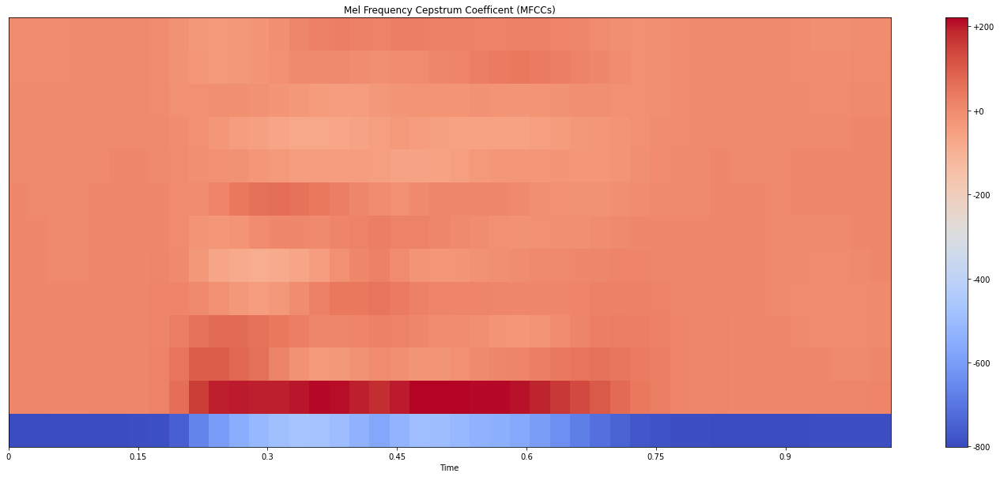

In [14]:
"""
:param name_Of_File : Split the directory and store in list. [-2] Return the second last index value.
"""
name_of_File = audio_Path.split("/")[-2]
print(name_of_File + " Audio\n")

random_Audio_Object.visualising_MFCCs()

In [15]:
# Creating second object of Meta_Data 
audio_Path2 = random.choice(data["files"])
random_Audio_Object2 = Meta_Data(audio_Path2)

# Calling play_Audio() method from class Meta_Data for first object
random_Audio_Object2.play_Audio()

close Audio

Shape of an audio:  (13, 44)


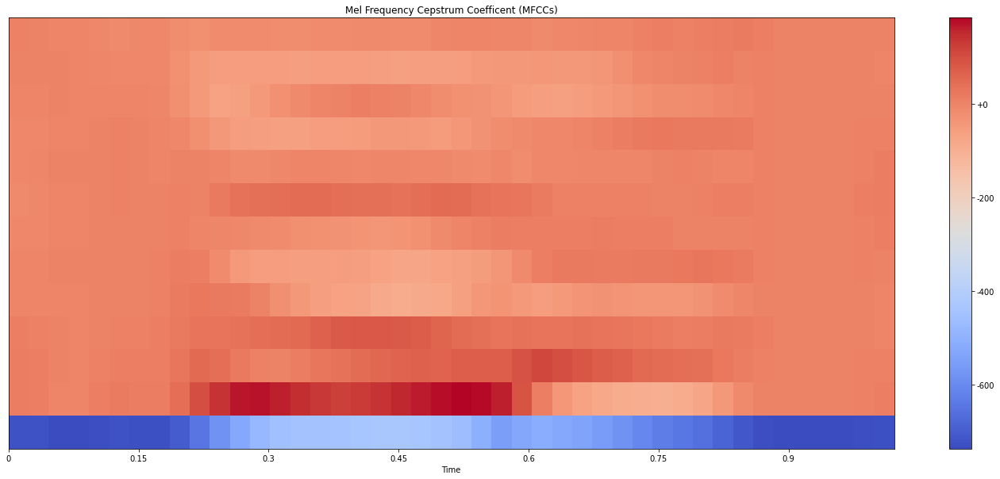

In [16]:
file_Path_Name = audio_Path2.split("/")[-2]
print(file_Path_Name + " Audio\n")
random_Audio_Object2.visualising_MFCCs()

<AxesSubplot:>

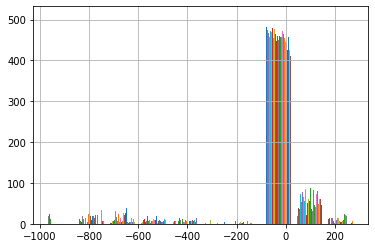

In [17]:
mfccs = df["MFCCs"]
mapping = df["mappings"]
labels = df["labels"]

mfccs.hist()

<AxesSubplot:>

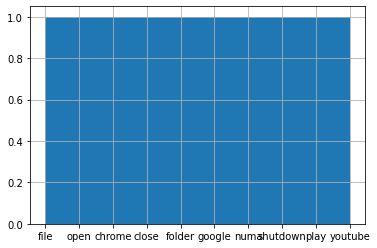

In [18]:
mapping.hist()

<AxesSubplot:>

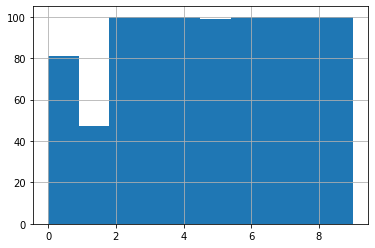

In [19]:
labels.hist()

(4) Creating Model

In [20]:
# Importing Library to create model
from sklearn.model_selection import train_test_split
import tensorflow.keras as keras
import tensorflow as tf

In [21]:
"""
Creating keyword spotting model for speech recognition system.

"""

class Create_Model():
    """
    Class to create model.
    """
    
    def __init__(self, data_Path, save_Model_Path, batch_size, epochs, learning_Rate):
        """
        Constructor function.
        
        :param data_Path : Path of the JSON file.
        :param save_Model : Path where .h5 model will be saved.
        :param batch_size : Number of sample processed before the model is updated.
        :param epochs : one entire transit of the training data through the algorithm.
        :param learning_Rate : Hyperparameter of lstm algorithm which decide how training process data will be selected 
                                due to which the building model can take long or short period of time.
        """
        
        self.data_Path = data_Path
        self.save_Model_Path = save_Model_Path
        self.batch_size = batch_size
        self.epochs = epochs
        self.learning_Rate = learning_Rate
    
    def load_Dataset(self, data_Path):
        """
        Loading JSON dataset.
        
        :var data : Dictionary to store json data after loading.
        :var X : Input feature.
        :var y : Output.
        """
        # Loading JSON File
        with open(data_Path, "r") as json_Data:
            data = json.load(json_Data)
            
        # Extract Inputs and Targets (or Labels) Features
        X = np.asarray(data["MFCCs"], dtype=object)
        y = np.asarray(data["labels"], dtype=object)
        
        return X, y
    
    def get_Data_Splits(self, data_Path, test_size=0.1, test_validation=0.1):
        """
        Splitting the data in train, test, validation.
        
        :param test_size : Size of test data from whole dataset.
        :param test_validation : Size of validation data from remaining tranning dataset.
        
        :var X_train : Input training data for model.
        :var X_test : Input testing data for model.
        :var X_validation : Input Validation data for model.
        
        :var y_train : Output training data for model.
        :var y_test : Output testing data for model. 
        :var y_validation : Output validation data for model.
        """
        # Load Dataset
        X, y = self.load_Dataset(self.data_Path)
        
        # split train/Validation/test 
        X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=test_size)
        X_train, X_validation, y_train, y_validation = train_test_split(X_train, y_train, test_size=test_validation)
        
        X_train = tf.convert_to_tensor(X_train, dtype=tf.float32) 
        X_validation = tf.convert_to_tensor(X_validation, dtype=tf.float32)
        X_test = tf.convert_to_tensor(X_test, dtype=tf.float32)
        y_train = tf.convert_to_tensor(y_train, dtype=tf.float32) 
        y_validation = tf.convert_to_tensor(y_validation, dtype=tf.float32)
        y_test = tf.convert_to_tensor(y_test, dtype=tf.float32)
        
        return X_train, X_validation, X_test, y_train, y_validation, y_test 
    
    def build_Model(self, input_shape, learning_Rate, error="sparse_categorical_crossentropy", number_Keywords=10):
        """
        Building the keyspotting model.
        
        :param error : Algorithm to calculate the error of model.
        :param number_Keywords : Number of word we collected for traning purpose.
        
        :var model : Model type.
        :var optimiser : Algorithm that helps to reduce loss or error and increase the accuracy of model.
        """
        # Build network
        model = keras.Sequential()
        
        # 2 LSTM Layer
        model.add(keras.layers.LSTM(64, input_shape=input_shape, return_sequences=True))
        model.add(keras.layers.LSTM(64))
        
        # Dense Layer
        model.add(keras.layers.Dense(64, activation="relu"))
        model.add(keras.layers.Dropout(0.3))
        
        # Softmax classifier (or Output layer)
        model.add(keras.layers.Dense(number_Keywords, activation="softmax")) # [0.1, 0.7, 0.2] 0.7 will be output
        
        # Compile the model
        optimiser = keras.optimizers.Adam(learning_rate=self.learning_Rate)
        model.compile(optimizer=optimiser, loss=error, metrics=["accuracy"])
        
        # Print model overview
        model.summary()
        
        return model
        
    def main(self):
        """
        Main function from where the process of creating model start.
        
        :var input_shape : input shape of the first node in neural network.
        :var test_error : Error of our model.
        :var test_accuracy : Accuracy of our model.
        """
        # train /  validation / test data splits
        X_train, X_validation, X_test, y_train, y_validation, y_test = self.get_Data_Splits(self.data_Path)
        
        # Building LSTM Model
        input_shape = (X_train.shape[1], X_train.shape[2])
        model = self.build_Model(input_shape, self.learning_Rate)
        
        # Train the data using model
        model.fit(X_train, y_train, epochs=self.epochs, batch_size=self.batch_size, validation_data=(X_validation, y_validation))
        
        # Evaluating the model
        test_error, test_accuracy = model.evaluate(X_test, y_test)
        print(f"Test error: {test_error}, Test accuracy: {test_accuracy}")
        
        # Saving model
        model.save(self.save_Model_Path)
        

In [22]:
# """
# Creating object of class Create_Model for English language.

# :var json_Path_English : Path of JSON dataset for English language.
# :var english_Model_Path : Path where english keyspotting model get saved. 
# """

# learning_Rate = 0.0001
# epochs = 100
# batch_size = 32

# # Data Path
# json_Path_English = "/home/atomyongya/Documents/Herald/Final Year Project/VoiceAssistant(Numa)/VoiceAssistant/1 System Model/2_English_KM/2_English_Json_Output_File/English_Data_JSON.json"

# # Model Path
# english_Model_Path = "/home/atomyongya/Documents/Herald/Final Year Project/VoiceAssistant(Numa)/VoiceAssistant/1 System Model/2_English_KM/3_English_Model_File/english_Model.h5"

# # Creating model object for English
# english_Model_Object = Create_Model(json_Path_English, english_Model_Path, batch_size, epochs, learning_Rate)

In [23]:
"""
Creating object of class create_Model for Nepali Language.
"""





'\nCreating object of class create_Model for Nepali Language.\n'

In [24]:
# Calling main function of object english_Model_Object
# english_Model_Object.main()

In [25]:
# Calling main function of object nepali_Model_Object



Making Prediction Using our model

In [26]:
"""
Importing Library necessary to predict our model
"""
import json
import sounddevice as sd
from scipy.io.wavfile import write 
from tensorflow.keras.models import load_model

In [ ]:
"""
Making prediction using english model we create.

:param fps: frame per second.
:param duaration : Record time duration.
:param filename : audio path.
:param mapping_Data : Loding the data to compare with our real time audio.
"""

fps = 44100
duration = 1
filename = "prediction.wav"
mapping_Data = data["mappings"]

# English keyword spotting model
model = load_model("/home/atomyongya/Documents/Herald/Final Year Project/VoiceAssistant(Numa)/VoiceAssistant/1 System Model/2_English_KM/3_English_Model_File/english_Model.h5")

print("Prediction Started: ")
while True:
    
    """
    :param myrecording :  Audio to predict real time user voice.
    :param prediction :  Prediction of real time audio voice.
    :param predicted_index : Hold the max prediction value of our model.
    :param predicted_keyword : Text word with which our voice will get compared. 
    """
    try:
        # Real time audio recording.  
        print("Say Now: ")
        myrecording = sd.rec(int(duration * fps), samplerate=fps, channels=2)
        sd.wait()
        write(filename, fps, myrecording)
        
        # Loading the recorded file using librosa.
        signal, sample_rate = librosa.load(filename)
        
        # Extracting the MFCC feature of an audio
        mfcc = librosa.feature.mfcc(signal, sample_rate, n_mfcc=13, hop_length=512, n_fft=2048)
        
        # Making prediction and comparing our audio mfcc with the mfcc of train audio data
        prediction = model.predict(tf.expand_dims(mfcc.T, axis=0))
        
        # Finding max prediction value and mapping with the index of mapping_Data from json. 
        predicted_index = np.argmax(prediction)
        predicted_keyword = mapping_Data[predicted_index]
        print(predicted_keyword)
        
        # To stop the audio record.
        stop = input("Enter S or s to stop: ")
        if stop == "s" or stop == "S":
            break

        else:
            continue
            
    except Exception as error:
        print(error)
        continue
    

Prediction Started: 
Say Now: 
in user code:

    File "/home/atomyongya/.local/lib/python3.8/site-packages/keras/engine/training.py", line 1621, in predict_function  *
        return step_function(self, iterator)
    File "/home/atomyongya/.local/lib/python3.8/site-packages/keras/engine/training.py", line 1611, in step_function  **
        outputs = model.distribute_strategy.run(run_step, args=(data,))
    File "/home/atomyongya/.local/lib/python3.8/site-packages/keras/engine/training.py", line 1604, in run_step  **
        outputs = model.predict_step(data)
    File "/home/atomyongya/.local/lib/python3.8/site-packages/keras/engine/training.py", line 1572, in predict_step
        return self(x, training=False)
    File "/home/atomyongya/.local/lib/python3.8/site-packages/keras/utils/traceback_utils.py", line 67, in error_handler
        raise e.with_traceback(filtered_tb) from None
    File "/home/atomyongya/.local/lib/python3.8/site-packages/keras/engine/input_spec.py", line 263, in 